In [2]:
# Importing Packages
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

In [26]:
# Reading in Temperature Data

temps = pd.read_excel("original data/Temps Data full.xls", sheet_name = None)
frames = [df for sheet, df in temps.items()]
temps_full = pd.concat(frames)

In [57]:
temps_full.head()

,BEGIN_DATE_GMT,END_DATE_GMT,SOURCE_DATETIME,SOURCE_TIMEZONE,NRG_STREAM_NAME,TEMP_CELSIUS,VERSION_BEGIN_LOCAL,VERSION_END_LOCAL
0,2010-01-01 07:00:00,2010-01-01 08:00:00,2010-01-01 00:00:00,MST,EC - Calgary Temp,-21.7,2020-03-02 09:02:14,NaN
1,2010-01-01 07:00:00,2010-01-01 08:00:00,2010-01-01 00:00:00,MST,EC - Fort McMurray Temp,-30.5,2020-03-02 09:02:14,NaN
2,2010-01-01 07:00:00,2010-01-01 08:00:00,2010-01-01 00:00:00,MST,EC - Lethbridge Temp,-19.9,2020-03-02 09:02:14,NaN
3,2010-01-01 07:00:00,2010-01-01 08:00:00,2010-01-01 00:00:00,MST,EC - Edmonton Temp,-24.3,2020-03-02 09:02:14,NaN
4,2010-01-01 08:00:00,2010-01-01 09:00:00,2010-01-01 01:00:00,MST,EC - Calgary Temp,-21.3,2020-03-02 09:02:14,NaN


In [61]:
temps_full.dtypes

BEGIN_DATE_GMT         datetime64[ns]
END_DATE_GMT           datetime64[ns]
SOURCE_DATETIME        datetime64[ns]
SOURCE_TIMEZONE                object
NRG_STREAM_NAME                object
TEMP_CELSIUS                  float64
VERSION_BEGIN_LOCAL    datetime64[ns]
VERSION_END_LOCAL             float64
dtype: object

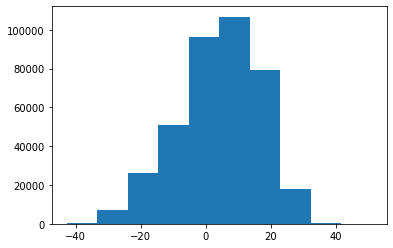

In [42]:
plt.hist(temps_full.TEMP_CELSIUS)
plt.show()

In [79]:
fig = px.histogram(temps_full, x = "TEMP_CELSIUS", nbins = 20, 
                   color = "NRG_STREAM_NAME", title = "Histogram of Temperatures",
                   opacity=0.5)
fig.show()

In [81]:
fig = px.scatter(temps_full, x = "BEGIN_DATE_GMT", y = "TEMP_CELSIUS" ,
                title = "Scatterplot of Temperatures")
fig.show()

In [76]:
#Reading in Price Data
ail_pool_price_sheet_1 = pd.read_excel("original data/AIL and Pool Price (2010-2020).xls", sheet_name = 0)
ail_pool_price_sheet_2 = pd.read_excel("original data/AIL and Pool Price (2010-2020).xls", sheet_name = 1)

ail_pool_prices = pd.concat([ail_pool_price_sheet_1,ail_pool_price_sheet_2])


,BEGIN_DATE_GMT,DATE,HE,POOL_PRICE,AIL_DEMAND
0,2010-01-01 07:00:00,2010-01-01,1,51.12,8307
1,2010-01-01 08:00:00,2010-01-01,2,48.79,8186
2,2010-01-01 09:00:00,2010-01-01,3,39.56,8075
3,2010-01-01 10:00:00,2010-01-01,4,36.27,8013
4,2010-01-01 11:00:00,2010-01-01,5,36.16,7982


In [45]:
temps_full.describe()

,TEMP_CELSIUS,VERSION_END_LOCAL
count,385756.000000,0.0
mean,4.195674,NaN
std,12.531103,NaN
min,-42.700000,NaN
25%,-3.800000,NaN
50%,5.200000,NaN
75%,13.700000,NaN
max,51.000000,NaN


In [77]:
ail_pool_prices.head()

,BEGIN_DATE_GMT,DATE,HE,POOL_PRICE,AIL_DEMAND
0,2010-01-01 07:00:00,2010-01-01,1,51.12,8307
1,2010-01-01 08:00:00,2010-01-01,2,48.79,8186
2,2010-01-01 09:00:00,2010-01-01,3,39.56,8075
3,2010-01-01 10:00:00,2010-01-01,4,36.27,8013
4,2010-01-01 11:00:00,2010-01-01,5,36.16,7982


In [62]:
ail_pool_prices.dtypes

BEGIN_DATE_GMT    datetime64[ns]
DATE              datetime64[ns]
HE                        object
POOL_PRICE               float64
AIL_DEMAND                 int64
dtype: object

In [82]:
start_date = "2020-01-01"
end_date = "2020-12-31"

ail_2020 = ail_pool_prices.loc[ (ail_pool_prices["DATE"] >= start_date)
                                     & (ail_pool_prices["DATE"] <= end_date)]

fig = px.scatter(ail_2020, x = "DATE", y = "AIL_DEMAND",
                title = "AIL Demand 2020")
fig.show()

In [83]:
date = "2020-01-01"

fig = px.scatter(ail_pool_prices.loc[ (ail_pool_prices["DATE"] == "2020-01-01")],
                 x = "HE", y = "AIL_DEMAND",
                title =  "AIL Demand 2020-01-01")
fig.show()